In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd

In [3]:
import matplotlib.gridspec as gridspec
import matplotlib.animation as animation
mpl.rcParams['animation.embed_limit'] = 4000

In [4]:
from windtools.common import calc_wind
from windtools.plotting import plot_timeheight, plot_timehistory_at_height, plot_profile, plot_spectrum

In [5]:
from statsmodels.tsa.stattools import acf
from scipy import integrate
from scipy.interpolate import interp2d

In [6]:
def myacfnk(x, nlags):   # acf adjusted=True
    acf = []
    for lag in range(nlags):
        # Slice the relevant subseries based on the lag
        y1 = x[:(len(x)-lag)]
        y2 = x[lag:]
        # Subtract the mean of the whole series x to calculate Cov
        sum_product = np.sum((y1-np.mean(x))*(y2-np.mean(x)))
        # Normalize with var of whole series
        acf.append( sum_product / ((len(x) - lag) * np.var(x)) )
    return acf


def myacfn(x, nlags):   #acf default (adjusted=False)
    acf=[]
    for lag in range(nlags):
        # Slice the relevant subseries based on the lag
        y1 = x[:(len(x)-lag)]
        y2 = x[lag:]
        # Subtract the mean of the whole series x to calculate Cov
        sum_product = np.sum((y1-np.mean(x))*(y2-np.mean(x)))
        # Normalize with var of whole series
        acf.append( sum_product / ((len(x)) * np.var(x)) )
    return acf

def myautocorr(x, nlags):
    autocorr = []
    for lag in range(nlags):
        # Slice the relevant subseries based on the lag
        y1 = x[:(len(x)-lag)]
        y2 = x[lag:]
        # Subtract the subseries means
        sum_product = np.sum((y1-np.mean(y1))*(y2-np.mean(y2)))
        # Normalize with the subseries stds
        autocorr.append( sum_product / ((len(x) - lag) * np.std(y1) * np.std(y2)) )
    return autocorr

In [7]:
def spatialCorrelation2D (ds, x0, y0, ti=None, tf=None, dateref=None):
    
    # Operations in time
    if dateref != None:
        ti = pd.to_datetime(ti, unit='s', origin = dateref)
        tf = pd.to_datetime(tf, unit='s', origin = dateref)
    ds = ds.sel(datetime=slice(ti,tf)).copy()
    times = ds.datetime.values
    
    #if 'wspd' not in list(ds.var()):
    #    ds['wspd'] = (ds.u**2 + ds.v**2)**0.5
    
    # find position of (x0, y0)
    iNearest = (abs(ds.x-x0)).argmin().values
    jNearest = (abs(ds.y-y0)).argmin().values
    
    print(f'Performing spatial correlation wrt to point ({ds.isel(x=iNearest).x.values}, ' \
          f'{ds.isel(y=jNearest).y.values}), between {ti} and {tf}.', end='\r', flush=True)
    
    mean = ds.sel(datetime=slice(ti,tf)).mean(dim=['datetime'])
    vlist=[]
    for i, t in enumerate(times):
        primeField = ds.sel(datetime=t) - mean
        v = primeField*primeField.isel(x=iNearest, y=jNearest)
        vlist.append(v)
    
    finalv = xr.concat(vlist, dim='datetime').mean(dim='datetime')
    finalv = finalv/finalv.isel(x=iNearest, y=jNearest)
    
    return finalv

In [8]:
def performCorrelationSubDomain (ds, nSubDomainsX, nSubDomainsY, outputnc=None, ti=133200, tf=133200+3*3600, window=1800, inc=600):
    '''
    Perform spatial correlations on subdomains with respect to the central point of each subdomain.
    This is useful on a periodic-type case in order to get smoother curves (analogous to a windowing for PSDs)

    '''
    if outputnc == None:
        outputnc = f'correlation{nSubDomainsX}x{nSubDomainsY}subdomain.nc'

    # Get subdomain limits
    xmin = ds.x[0].values;  xmax = ds.x[-1].values
    ymin = ds.y[0].values;  ymax = ds.y[-1].values
    xSubDom = np.linspace(xmin, xmax, nSubDomainsX+1)
    ySubDom = np.linspace(ymin, ymax, nSubDomainsY+1)
    x0SubDom = (xSubDom[1:] + xSubDom[:-1]) / 2
    y0SubDom = (ySubDom[1:] + ySubDom[:-1]) / 2

    vlist = []
    while ti+window <= tf:
        ti_dt = pd.to_datetime(ti, unit='s', origin=dateref)
        tf_dt = pd.to_datetime(ti+window, unit='s', origin=dateref)
        for i, _ in enumerate(xSubDom[:-1]):
            for j, _ in enumerate(ySubDom[:-1]):
                x0 = x0SubDom[i];  y0 = y0SubDom[j]
                dssub = ds.sel(x=slice(xSubDom[i],xSubDom[i+1]-1), y=slice(ySubDom[j],ySubDom[j+1]-1)).copy()

                v_curr = spatialCorrelation2D(dssub, x0=x0, y0=y0, ti=ti, tf=ti+window, dateref=dateref)
                v_curr = v_curr.expand_dims('datetime').assign_coords({'datetime': [ti_dt]})
                vlist.append(v_curr)
        ti = ti + inc

    # concatenate the resulting list. Workaround to merge same datetime together as it should
    vsubdom = xr.concat(vlist, dim='datetime').to_dataframe().dropna().to_xarray()

    vsubdom.to_netcdf(os.path.join(procdatadir, outputnc))
    
    return vsubdom

In [9]:
def getSpaceCorrAlongWindDir (ds, dsv, nSubDomainsX, nSubDomainsY, window=1800, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected'):
    '''
    Calculates the spatial correlation values along the streamwise and cross-stream direction.
    Streamwise direction is determined as along the mean wind direction for intervals defined
    in the correlation DataSet. Cross-stream direction is defined as 90deg from streamwise.
    
    Inputs:
    -------
    ds: xArray DataSet
        Windspeed and wind direction data, as well as grid information for all times. Usually
        the output of VTK-reading functions
    dsv: xArray DataSet
        Spatial correlation data. Output of `performCorrelationSubDomain`
    window: int
        window, in seconds, to get the mean wdir from
        
    Outputs:
    --------
    v_long: np.array
        Correlation along the streamwise direction (`long` for longitudinal)
    v_tran: np.array
        Correlation along the cross-stream direction (`tran` for transverse)
    x_{long,tran}: np.array
        Auxiliary array for proper plotting. `x` represents the direction
    L_{long,tran}: np.array
        Integral time scale for the streamwise and cross-stream direction, respectively
    L_{long,tran)_: np.array:
        Same as above, but computed on only half the domain and up to the point where
        it crosses the corr=0 threshold
        
    '''
    
    # Get subdomain limits
    xmin = ds.x[0].values;  xmax = ds.x[-1].values
    ymin = ds.y[0].values;  ymax = ds.y[-1].values
    xSubDom = np.linspace(xmin, xmax, nSubDomainsX+1)
    ySubDom = np.linspace(ymin, ymax, nSubDomainsY+1)
    x0SubDom = (xSubDom[1:] + xSubDom[:-1]) / 2
    y0SubDom = (ySubDom[1:] + ySubDom[:-1]) / 2
    
    # Assumes uniform window
    #window = dsv.datetime[1] - dsv.datetime[0]
    window = pd.to_timedelta(window, unit='s')
    
    # get correlations streamwise and cross-stream, as well as int scales
    # (ending in underscore means integral up to the point it crosses 0)
    tv_long = [];  L_long = [];  L_long_ = [];  tau_long = [];  tau_long_ = []
    tv_tran = [];  L_tran = [];  L_tran_ = [];  tau_tran = [];  tau_tran_ = []

    # define the linelong and longtran to the total mean (spatial and temporal)
    tlinelong = np.arange( -0.5*(xSubDom[1]-xSubDom[0]), 0.5*(xSubDom[1]-xSubDom[0]), 10)
    tlinetran = np.arange( -0.5*(ySubDom[1]-ySubDom[0]), 0.5*(ySubDom[1]-ySubDom[0]), 10)
    
    for t, d in enumerate(dsv.datetime):
        subv_long = [];  subv_tran = []; 
        subv = dsv.sel(datetime=d)
        wdir_uncorrected = ds.sel(datetime=slice(d,d+window))[wdirvar].mean().values

        for i in range(len(x0SubDom)):
            for j in range(len(y0SubDom)):
                x0 = x0SubDom[i];  y0 = y0SubDom[j]
                subsubv = subv.sel(x=slice(xSubDom[i],xSubDom[i+1]-1), y=slice(ySubDom[j],ySubDom[j+1]-1))

                # Define points along the streamwise direction going through (x0, y0)
                xxlong = np.arange(xSubDom[i], xSubDom[i+1], 10)
                a = -np.tan(np.deg2rad(wdir_uncorrected-90));  b = y0 - a*x0
                yylong = a*xxlong + b

                # Define points along the cross flow directions, going through (x0, y0)
                yytran = np.arange(ySubDom[j], ySubDom[j+1], 10)
                a =  np.tan(np.deg2rad(360-wdir_uncorrected));  b = y0 - a*x0
                xxtran = (yytran -b)/a

                # get the correlations along the two directions
                #v_long = np.hstack([subsubv.sel(x=xxlong[i], y=yylong[i], method='nearest')[correlationvar].values for i in range(len(xxlong))])
                #v_tran = np.hstack([subsubv.sel(x=xxtran[i], y=yytran[i], method='nearest')[correlationvar].values for i in range(len(yytran))])
                # new fix
                f = interp2d(subsubv.x, subsubv.y, subsubv.spcorr_wspd_corrected)
                v_long = [float(f(XX,YY)) for XX,YY in zip(xxlong,yylong)]
                v_tran = [float(f(XX,YY)) for XX,YY in zip(xxtran,yytran)]

                # Create 1-D array of distance across the long/transverse line
                linelong = np.linspace(0, ((xxlong[-1]-xxlong[0])**2 + (yylong[-1]-yylong[0])**2)**0.5, num=len(v_long) )
                linetran = np.linspace(0, ((xxtran[-1]-xxtran[0])**2 + (yytran[-1]-yytran[0])**2)**0.5, num=len(v_tran) )

                # Center line around the central point being at 0
                linelong = linelong - linelong[np.argmax(v_long)]
                linetran = linetran - linetran[np.argmax(v_tran)]

                # Concatenate results for current time interval      
                subv_long.append(v_long)
                subv_tran.append(v_tran)

        subv_long = np.mean(subv_long, axis=0)
        subv_tran = np.mean(subv_tran, axis=0)

        # Get values onto a common line for plotting
        tv_long.append(np.interp(tlinelong, linelong, subv_long))
        tv_tran.append(np.interp(tlinetran, linetran, subv_tran))

        # Calculate the integral length scale of the chunk-average
        L_long.append(np.trapz(tv_long[t], tlinelong))
        L_tran.append(np.trapz(tv_tran[t], tlinetran))
        
        
        # Calculate the integral length scale of the chunk-average. Only getting the right-half for the integral
        v_long = np.split(tv_long[t], 2)[1]
        v_tran = np.split(tv_tran[t], 2)[1]
        x_long = np.split(tlinelong, 2)[1]
        x_tran = np.split(tlinetran, 2)[1]
        #print(f'v_long[0] is {v_long[0]} and v_tran[0] is {v_tran[0]}')
        assert x_tran[0] == 0
        assert x_tran[0] == 0
        assert v_long[0] >= 0.9999
        assert v_tran[0] >= 0.9999
        # get instant that crosses zero
        pos0cross_long = np.argmax(v_long<0)
        pos0cross_tran = np.argmax(v_tran<0)
        if pos0cross_long == 0:
            # doesn't cross, so integrating the whole half-curve
            L_long_.append(np.trapz(v_long, x_long))
        else:
            # it crosses 0, so integrate up to that point
            L_long_.append(np.trapz(v_long[:pos0cross_long], x_long[:pos0cross_long]))
        if pos0cross_tran == 0:
            L_tran_.append(np.trapz(v_tran, x_tran))
        else:
            L_tran_.append(np.trapz(v_tran[:pos0cross_tran], x_tran[:pos0cross_tran]))
        
        
        # Calculate the integral time scale based on the int length scale and space-mean windspeed
        wdpd = ds.sel(datetime=slice(d,d+window))[wspdvar].mean().values
        tau_long.append(np.trapz(tv_long[t], tlinelong)/wdpd)
        tau_tran.append(np.trapz(tv_tran[t], tlinetran)/wdpd)
        tau_long_.append(L_long_[t]/wdpd)
        

    tv_long = np.vstack(tv_long)
    tv_tran = np.vstack(tv_tran)

    return {'v_long':tv_long, 'v_tran':tv_tran, 'x_long':tlinelong, 'x_tran':tlinetran, 'L_long':L_long, 'L_tran':L_tran, \
            'tau_long':tau_long, 'tau_tran':tau_tran, 'L_long_':L_long_, 'L_tran_':L_tran_, 'tau_long_':tau_long_}

In [10]:
def plotCorrelationCurves(vcomplete, spaceCorr, title, xlim=None):

    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(18,6.5), gridspec_kw={'width_ratios': [2.2, 1]})
    axs = axs.flatten()
    
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i) for i in np.linspace(0.2, 1, len(vcomplete.datetime))])
    axs[2].set_prop_cycle('color',[plt.cm.Blues(i) for i in np.linspace(0.2, 1, len(vcomplete.datetime))])
    
    # spatial correlation curves plot
    for i, date in enumerate(vcomplete.datetime.values):
        axs[0].plot(spaceCorr['x_long'], spaceCorr['v_long'][i], alpha=0.6, label=date)
        axs[2].plot(spaceCorr['x_tran'], spaceCorr['v_tran'][i], alpha=0.6, label=date)
    axs[0].plot(spaceCorr['x_long'], spaceCorr['v_long'].mean(axis=0), linewidth=2, color='r')
    axs[2].plot(spaceCorr['x_tran'], spaceCorr['v_tran'].mean(axis=0), linewidth=2, color='r', label='average')
    if xlim != None:
        axs[0].set_xlim(xlim)
        axs[2].set_xlim(xlim)

    # Integral length scale plot
    #axs[1].plot(vcomplete.datetime, spaceCorr['L_long'], label='L streamwise', c='tab:blue', linestyle='dashed') # full integral, both sides, no 0-cross
    axs[1].plot(vcomplete.datetime, spaceCorr['L_long_'], label='L streamwise half-dom 0-cross', c='tab:blue', linestyle='dashed')
    #axs[1].plot(vcomplete.datetime, [i*2 for i in spaceCorr['L_long_']], label='L streamwise double half-dom 0-cross', c='tab:blue') 
    
    #axs[1].plot(vcomplete.datetime, spaceCorr['L_tran'], label='L cross-stream', c='tab:orange', linestyle='dashed') # full integral, both sides, no 0-cross
    axs[1].plot(vcomplete.datetime, spaceCorr['L_tran_'], label='L cross-stream half-dom 0-cross', c='tab:orange', linestyle='dashed')
    #axs[1].plot(vcomplete.datetime, [i*2 for i in spaceCorr['L_tran_']], label='L cross-stream double half-dom 0-cross', c='tab:orange') # 
    
    # Integral time scale plot
    #axs[3].plot(vcomplete.datetime, spaceCorr['tau_long'], label='tau streamwise', c='tab:blue', linestyle='dashed') # full integral, both sides, no 0-cross
    axs[3].plot(vcomplete.datetime, spaceCorr['tau_long_'], label='tau streamwise half-dom 0-cross', c='tab:blue')
    #axs[3].plot(vcomplete.datetime, [i*2 for i in spaceCorr['tau_long_']], label='tau streamwise double half-dom 0-cross', c='tab:blue', linestyle='dashed')
    #axs[3].plot(vcomplete.datetime, spaceCorr['tau_tran'], label='tau cross-stream')
    
    # Axes and labels
    fig.suptitle(f'Correlation over {title} subdomain grid wrt local central point')
    axs[0].set_title('streamwise direction');
    axs[2].set_title('cross-stream direction')
    axs[1].set_title(f'Integral length scale based on {title} sub-domains')
    axs[3].set_title(f'Integral time scale based on {title} sub-domains')
    
    axs[0].set_ylabel('corr');  axs[2].set_ylabel('corr');
    axs[1].set_ylabel('int length scale (m)');  axs[3].set_ylabel('int time scale (s)');
    axs[2].set_xlabel('distance from correlation point [m]');   axs[1].set_xlabel('time (UTC)');  axs[3].set_xlabel('time (UTC)') 

    axs[1].legend();  axs[3].legend(); #axs[2].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    #axs[0].legend()
    for ax in axs: ax.grid(); 

    plt.tight_layout()

# FINO1 SOWFA microscale case: spatial and temporal correlation analysis

This notebook uses processed data, generated by running the previous notebooks in the series.


Regis Thedin \
June 2021

In [11]:
# Paths
vtkcasepath = '/projects/mmc/rthedin/OpenFOAM/rthedin-6/run/offshoreCases/02_fino_sampling/'
probecasepath = '/scratch/rthedin/OpenFOAM/rthedin-6/run/offshore/03_fino_sampling/'
obspath = '~/a2e-mmc/assessment/studies/fino_offshore_microscale/'
wrfpath = '/projects/mmc/rthedin/OpenFOAM/rthedin-6/run/offshoreCases'

In [12]:
figdir = os.path.join(vtkcasepath,'figures')
procdatadir = os.path.join(vtkcasepath,'processedFiles')

if not os.path.exists(figdir):
    os.makedirs(figdir)
if not os.path.exists(procdatadir):
    os.makedirs(procdatadir)

## 1. Load data

### Times
Perform operations in time. OpenFOAM only deals with seconds.

- WRF/WTK data comes in `datetime` already and goes from `datefrom` to `dateto`.
- SOWFA time `0` is related to `dateref`. That is done to align the WRF/WTK output to forcing. 


In [13]:
# WRF
datefrom = pd.to_datetime('2010-05-14 12:00:03')
dateto = pd.to_datetime('2010-05-17 00:00:00')

# SOWFA
dateref = pd.to_datetime('2010-05-14 12:00:00')
LESfrom=pd.to_datetime('2010-05-16 01:00:00')
LESto=pd.to_datetime('2010-05-16 05:00:00')
LESspinupfrom = LESfrom - pd.Timedelta(seconds=20000)

### Load corrected and uncorrected SOWFA VTK data

In [14]:
ds80m_full = xr.open_dataset(os.path.join(procdatadir, 'ds_VTK80m_01Z_04Z_sowfa_complete.nc'))
ds80m_full = ds80m_full.rename({'u':'u_uncorrected', 'v':'v_uncorrected', 'w':'w_uncorrected', 'wspd':'wspd_uncorrected', 'wdir':'wdir_uncorrected'})

In [15]:
# Re-organize the dataset
ds80m_full['wspd_corrected'] = ds80m_full['wspd_uncorrected'] - ds80m_full['cosfit']

### Load observation dataset
High-frequency observation dataset sent by Raj on April 8. Processing and creation of netCDF file available on A2e's github page under `assessment/studies/fino_offshore_microscale/`.

In [16]:
obsrajfull = xr.open_dataset(os.path.join(obspath, 'FINO1_obs_10Hz.nc'))

In [17]:
# Get only the period of interest
obs = obsrajfull.sel(datetime=slice(LESfrom,LESto))

### Recall the corrected flowfield
The animation is shown with 5-min temporal resolution. Change the `5` in line 22 and 32 to other value to change the temporal resolution. One minute is the maximum resolution available.

In [18]:
x = ds80m_full.x    
y = ds80m_full.y
wspd_uncorrected = ds80m_full.isel(datetime=0).wspd_uncorrected
cosfit = ds80m_full.isel(datetime=0).cosfit
wspd_corrected = wspd_uncorrected - cosfit

fig, axs = plt.subplots(ncols=3, figsize=(16, 3.9)) 

p1 = axs[0].pcolormesh(x,y,wspd_uncorrected,  vmin=12, vmax=16, shading='auto')
cb1 = fig.colorbar(p1,ax=axs[0], label='wspd [m/s]'); axs[0].set_title(f'uncorrected instantaneous')

p2 = axs[1].pcolormesh(x,y,cosfit, vmin=-0.8, vmax=0.8, shading='auto')
cb2 = fig.colorbar(p2, ax=axs[1], label='wspd [m/s]'); axs[1].set_title(f'fitted cosine over uncorrected perturbation')

p3 = axs[2].pcolormesh(x,y,wspd_corrected,  vmin=12, vmax=16, cmap='viridis', shading='auto')
cb3 = fig.colorbar(p3,ax=axs[2], label='wspd [m/s]'); axs[2].set_title(f'corrected instantaneous')
    
for ax in axs:  ax.set_xlim([0,6000]);  ax.set_ylim([0,6000]);  ax.set_aspect('equal', 'box');  ax.axis('off')
    
    
def animate(i):
    wspd_uncorrected = ds80m_full.isel(datetime=5*60*i).wspd_uncorrected.values
    cosfit = ds80m_full.isel(datetime=60*i).cosfit.values
    wspd_corrected = wspd_uncorrected - cosfit
    
    p1.set_array(wspd_uncorrected.ravel())
    p2.set_array(cosfit.ravel())
    p3.set_array(wspd_corrected.ravel())
    fig.suptitle(f'{pd.to_datetime(ds80m_full.isel(datetime=60*i).datetime.values)}')
    return

anim = animation.FuncAnimation(fig,animate,frames=int(180/5),interval=150,blit=False,repeat=False)

# To get only the animation
plt.close()

from IPython.display import HTML
HTML(anim.to_jshtml())

# Spatial correlation: corrected data

Here we do spatial correlation over chunks, with a 10-min overlap (except when using 10-min chunk, then the overlap is only 5-min). For efficiency we save/load files.

In [19]:
# Time parameters
ti=133200
tf=133200+3*3600

### 30-min chunks

In [20]:
window=1800
inc=600 # marching of the window (controls overlap)

In [21]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_30min_complete.nc')):
    v1x1complete30 = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_30min_complete.nc'))
else:
    v1x1complete30 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 1, 1, outputnc='correlation1x1subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_30min_complete.nc')):
    v2x2complete30 = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_30min_complete.nc'))
else:
    v2x2complete30 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 2, 2, outputnc='correlation2x2subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_30min_complete.nc')):
    v3x3complete30 = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_30min_complete.nc'))
else:
    v3x3complete30 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 3, 3, outputnc='correlation3x3subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_30min_complete.nc')):
    v4x4complete30 = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_30min_complete.nc'))
else:
    v4x4complete30 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 4, 4, outputnc='correlation4x4subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

In [22]:
# Reanaming for clarity
v1x1complete30 = v1x1complete30.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v2x2complete30 = v2x2complete30.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v3x3complete30 = v3x3complete30.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v4x4complete30 = v4x4complete30.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})

### 20-min chunks

In [23]:
window=1200
inc=600 # marching of the window (controls overlap)

In [24]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_20min_complete.nc')):
    v1x1complete20 = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_20min_complete.nc'))
else:
    v1x1complete20 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 1, 1, outputnc='correlation1x1subdom_20min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_20min_complete.nc')):
    v2x2complete20 = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_20min_complete.nc'))
else:
    v2x2complete20 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 2, 2, outputnc='correlation2x2subdom_20min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_20min_complete.nc')):
    v3x3complete20 = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_20min_complete.nc'))
else:
    v3x3complete20 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 3, 3, outputnc='correlation3x3subdom_20min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_20min_complete.nc')):
    v4x4complete20 = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_20min_complete.nc'))
else:
    v4x4complete20 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 4, 4, outputnc='correlation4x4subdom_20min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

In [25]:
# Reanaming for clarity
v1x1complete20 = v1x1complete20.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v2x2complete20 = v2x2complete20.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v3x3complete20 = v3x3complete20.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v4x4complete20 = v4x4complete20.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})

### 15-min chunks

In [26]:
window=900
inc=600 # marching of the window (controls overlap)

In [27]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_15min_complete.nc')):
    v1x1complete15 = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_15min_complete.nc'))
else:
    v1x1complete15 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 1, 1, outputnc='correlation1x1subdom_15min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_15min_complete.nc')):
    v2x2complete15 = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_15min_complete.nc'))
else:
    v2x2complete15 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 2, 2, outputnc='correlation2x2subdom_15min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_15min_complete.nc')):
    v3x3complete15 = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_15min_complete.nc'))
else:
    v3x3complete15 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 3, 3, outputnc='correlation3x3subdom_15min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_15min_complete.nc')):
    v4x4complete15 = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_15min_complete.nc'))
else:
    v4x4complete15 = performCorrelationSubDomain(ds80m_full[['wspd','wspd_corr']], 4, 4, outputnc='correlation4x4subdom_15min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

In [28]:
# Reanaming for clarity
v1x1complete15 = v1x1complete15.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v2x2complete15 = v2x2complete15.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v3x3complete15 = v3x3complete15.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})
v4x4complete15 = v4x4complete15.rename({'wspd':'spcorr_wspd_uncorrected' , 'wspd_corr':'spcorr_wspd_corrected'})

### 10-min chunks


In [29]:
window=600
inc=300 # marching of the window (controls overlap)

In [30]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_10min_complete.nc')):
    v1x1complete10 = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_10min_complete.nc'))
else:
    v1x1complete10 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 1, 1, outputnc='correlation1x1subdom_10min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_10min_complete.nc')):
    v2x2complete10 = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_10min_complete.nc'))
else:
    v2x2complete10 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 2, 2, outputnc='correlation2x2subdom_10min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_10min_complete.nc')):
    v3x3complete10 = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_10min_complete.nc'))
else:
    v3x3complete10 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 3, 3, outputnc='correlation3x3subdom_10min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_10min_complete.nc')):
    v4x4complete10 = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_10min_complete.nc'))
else:
    v4x4complete10 = performCorrelationSubDomain(ds80m_full[['wspd_uncorrected','wspd_corrected']], 4, 4, outputnc='correlation4x4subdom_10min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

In [31]:
# Reanaming for clarity
v1x1complete10 = v1x1complete10.rename({'wspd_uncorrected':'spcorr_wspd_uncorrected' , 'wspd_corrected':'spcorr_wspd_corrected'})
v2x2complete10 = v2x2complete10.rename({'wspd_uncorrected':'spcorr_wspd_uncorrected' , 'wspd_corrected':'spcorr_wspd_corrected'})
v3x3complete10 = v3x3complete10.rename({'wspd_uncorrected':'spcorr_wspd_uncorrected' , 'wspd_corrected':'spcorr_wspd_corrected'})
v4x4complete10 = v4x4complete10.rename({'wspd_uncorrected':'spcorr_wspd_uncorrected' , 'wspd_corrected':'spcorr_wspd_corrected'})

## Spatial correlation visualization
Differently from the scenario before correcting for the gravity waves, now the correlation is aligned with the mean wind direction, as it should. Plotted is the overall mean across the whole 3-hour internval

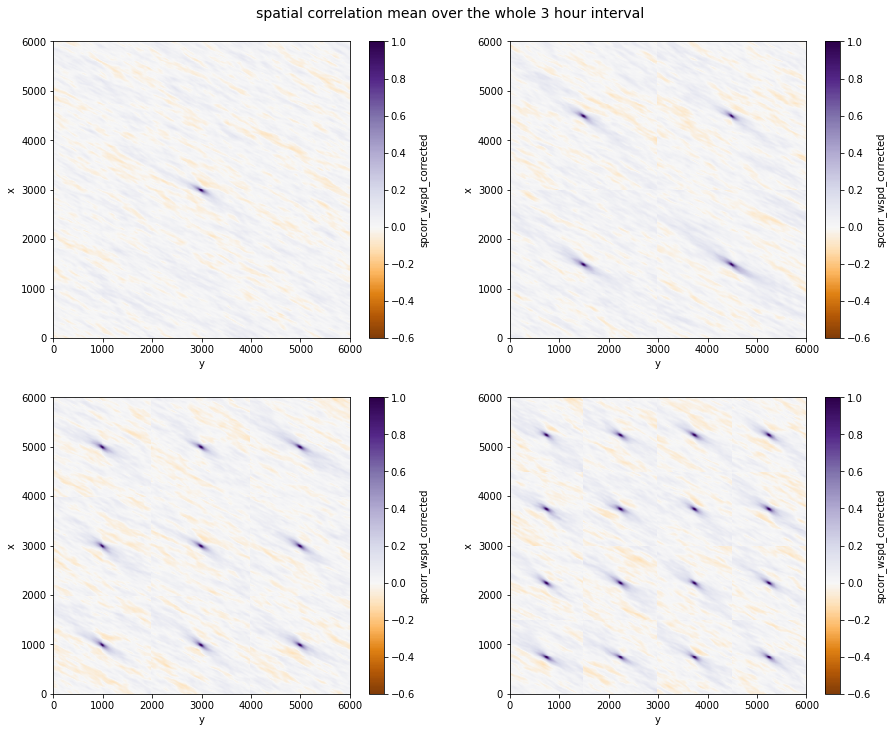

In [32]:
fig, axs= plt.subplots(nrows=2, ncols=2, figsize=(15,12))
axs=axs.flatten()
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
                               
v1x1complete30.mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v2x2complete30.mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[1], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v3x3complete30.mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[2], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v4x4complete30.mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[3], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')

for ax in axs:
    ax.set_ylim([0, 6000])
    ax.set_xlim([0, 6000])
    ax.set_aspect('equal', 'box')
fig.suptitle('spatial correlation mean over the whole 3 hour interval', y=0.92, fontsize=14)
plt.show()

#### Sanity check
I will want to sample the values along the clear direction that we can see in the plots above. This is a sanity check to see if I'm getting the values actually along the correct line.

Let's see if the resulting correlation now is actually aligned with the flowfield. For that, let's see the corrected and uncorrected data. Just is just a sanity-check to know that when we get the along-flow correlation, we are indeed getting along the correlation. Using the 1x1 subdomain data.

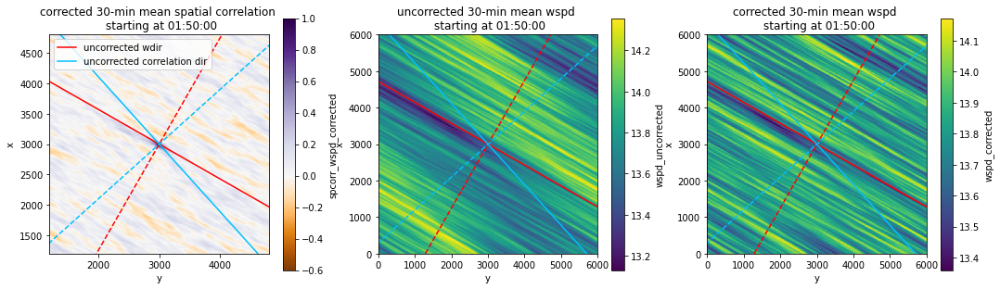

In [33]:
x0=3000
y0=3000

d=v1x1complete30.datetime[5]

# get mean wdir over interval
wdir_uncorrected = ds80m_full['wdir_uncorrected'].sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean().values
wdir_uncorrected
# eye-ball estimate of correlation of uncorrected wspd (the very clear wave pattern; not shown in this notebook)
corrdir = 318

# wdir aligned
# Define points along the streamwise direction going through (x0, y0)
xxlongitudinal = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(wdir_uncorrected-90));  b = y0 - a*x0
yylongitudinal = a*xxlongitudinal + b
# Define points along the transverse flow directions, going through (x0, y0)
yytransverse = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-wdir_uncorrected));  b = y0 - a*x0
xxtransverse = (yytransverse -b)/a

# corrdir-aligned
# Define points along the streamwise direction going through (x0, y0)
xxlon = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(corrdir-90));  b = y0 - a*x0
yylon = a*xxlon + b
# Define points along the transverse flow directions, going through (x0, y0)
yytran = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-corrdir));  b = y0 - a*x0
xxtran = (yytran -b)/a


fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18,5), gridspec_kw={'hspace': 0.4})
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

v1x1complete30.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
ds80m_full.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd_uncorrected.plot(ax=axs[1], cmap='viridis')
ds80m_full.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd_corrected.plot(ax=axs[2], cmap='viridis')

for ax in axs:
    ax.plot(xxlongitudinal, yylongitudinal, 'red', label='uncorrected wdir');     # uncorrected-wdir aligned
    ax.plot(xxtransverse, yytransverse, '--', color='red');                       # uncorrected-wdir transverse     
    ax.plot(xxlon, yylon, 'deepskyblue', label='uncorrected correlation dir');      # corrected correlation dir aligned
    ax.plot(xxtran, yytran,'--', color='deepskyblue');                            # corrected correlation dir transverse
    ax.set_title(d.values);                      
    ax.set_ylim([0, 6000]);                      
    ax.set_xlim([0, 6000]);                      
    ax.set_aspect('equal', 'box');     
axs[0].set_ylim([1200, 4800]);                      
axs[0].set_xlim([1200, 4800]); 
axs[0].legend(loc='upper left')
axs[0].set_title(f'corrected 30-min mean spatial correlation \n starting at {pd.to_datetime(d.values):%H:%M:%S}')
axs[1].set_title(f'uncorrected 30-min mean wspd \n starting at {pd.to_datetime(d.values):%H:%M:%S}')
axs[2].set_title(f'corrected 30-min mean wspd \n starting at {pd.to_datetime(d.values):%H:%M:%S}')
plt.show()

Conclusions from the plot above:
1. the correlation of the corrected flowfield has the same direction as the mean wind speed. I didn't put a line over, but it's clear that the correlation direction follows the mean wind speed from the third plot (which also follows the red line)
2. The blue curve is a result of the correlation of the data presented in the middle plot. See how the wind direction in the middle plot is aligned with that.
3. So we're getting the blue lines from the middle and throwing into the correlation of the corrected data to see if the correlation direction is still the same or not. It is not-- it is now aligned with the mean wspd (red)
4. Thus: we will sample along the red line

## Spatial correlation: sampling and plotting wind-aligned spatially-averaged correlations based on corrected flowfield

Get values from lines along the mean wind direction

In [34]:
# 30min
spaceCorr4x4_30 = getSpaceCorrAlongWindDir( ds80m_full, v4x4complete30, nSubDomainsX=4, nSubDomainsY=4, window=1800, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
spaceCorr3x3_30 = getSpaceCorrAlongWindDir( ds80m_full, v3x3complete30, nSubDomainsX=3, nSubDomainsY=3, window=1800, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
#spaceCorr2x2_30 = getSpaceCorrAlongWindDir( ds80m_full, v2x2complete30, nSubDomainsX=2, nSubDomainsY=2, window=1800, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
#spaceCorr1x1_30 = getSpaceCorrAlongWindDir( ds80m_full, v1x1complete30, nSubDomainsX=1, nSubDomainsY=1, window=1800, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')


In [35]:
# 20min
spaceCorr4x4_20 = getSpaceCorrAlongWindDir( ds80m_full, v4x4complete20, nSubDomainsX=4, nSubDomainsY=4, window=1200, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
spaceCorr3x3_20 = getSpaceCorrAlongWindDir( ds80m_full, v3x3complete20, nSubDomainsX=3, nSubDomainsY=3, window=1200, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')


In [36]:
# 15min
spaceCorr4x4_15 = getSpaceCorrAlongWindDir( ds80m_full, v4x4complete15, nSubDomainsX=4, nSubDomainsY=4, window=900, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
spaceCorr3x3_15 = getSpaceCorrAlongWindDir( ds80m_full, v3x3complete15, nSubDomainsX=3, nSubDomainsY=3, window=900, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')


In [37]:
# 10min
spaceCorr4x4_10 = getSpaceCorrAlongWindDir( ds80m_full, v4x4complete10, nSubDomainsX=4, nSubDomainsY=4, window=600, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')
spaceCorr3x3_10 = getSpaceCorrAlongWindDir( ds80m_full, v3x3complete10, nSubDomainsX=3, nSubDomainsY=3, window=600, wdirvar='wdir_uncorrected', wspdvar='wspd_corrected', correlationvar='spcorr_wspd_corrected')


Plot a sample of the correlation curves. Using the 30-min case on the 4x4 sub-domains

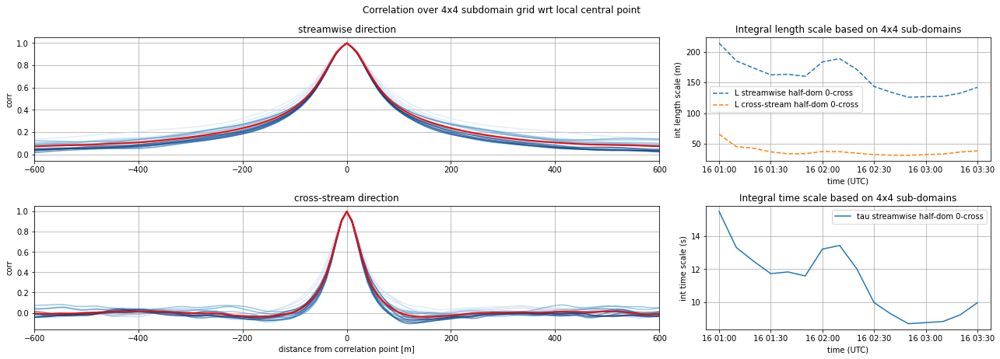

In [38]:
plotCorrelationCurves(vcomplete=v4x4complete30, spaceCorr = spaceCorr4x4_30, title='4x4', xlim=[-600, 600])

The integral time scale above is simply based on the computed integral length scale and the mean windpeed at that interval, thus the trends are similar. The 1x1 domain has higher variance because we are not averaging in space. So let's focus on the 4x4 domain.

Let's get the length scale of an ellipse around a constant correlation value

In [39]:
# average across the 16 subdomains:
window = pd.to_timedelta(1800, unit='s')
dsv=v4x4complete30
nSubDomainsX = nSubDomainsY =4

# Get subdomain limits
xmin = ds80m_full.x[0].values;  xmax = ds80m_full.x[-1].values
ymin = ds80m_full.y[0].values;  ymax = ds80m_full.y[-1].values
xSubDom = np.linspace(xmin, xmax, nSubDomainsX+1)
ySubDom = np.linspace(ymin, ymax, nSubDomainsY+1)
x0SubDom = (xSubDom[1:] + xSubDom[:-1]) / 2
y0SubDom = (ySubDom[1:] + ySubDom[:-1]) / 2

avgv = []
for t, d in enumerate(dsv.datetime):
    wdir_uncorrected = ds80m_full.sel(datetime=slice(d,d+window))['wdir_uncorrected'].mean().values
    subsubvavg = []
    subv = dsv.sel(datetime=d)
    for i in range(len(x0SubDom)):
        for j in range(len(y0SubDom)):
            x0 = x0SubDom[i];  y0 = y0SubDom[j]
            subsubv = subv.sel(x=slice(xSubDom[i],xSubDom[i+1]-1), y=slice(ySubDom[j],ySubDom[j+1]-1)) 
            subsubvavg.append( subsubv.assign_coords({'x':subsubv.x-x0, 'y':subsubv.y-y0}).expand_dims('datetime') )
    subsubvavg = xr.concat(subsubvavg, dim='datetime').mean(dim='datetime')
    subsubvavg = subsubvavg.expand_dims('datetime').assign_coords({'datetime': [d.values]})
    subsubvavg = subsubvavg.assign({'wdir_uncorrected': ('datetime', [wdir_uncorrected])})
    avgv.append(subsubvavg)
avgv = xr.concat(avgv, dim='datetime')

avgv4x4=avgv

In [40]:
avgv=avgv4x4
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

x = avgv.x    
y = avgv.y
corrToPlot = avgv.sel(datetime=avgv.datetime[0]).spcorr_wspd_corrected
wdir = avgv.sel(datetime=avgv.datetime[0]).wdir_uncorrected

fig, axs = plt.subplots(ncols=2, figsize=(16,6)) 

p1 = axs[0].pcolormesh(x,y,corrToPlot,   norm=norm, cmap='PuOr', shading='auto')
p1q= axs[0].quiver(0,0, np.cos(np.deg2rad(wdir-270)), -np.sin(np.deg2rad(wdir-270)), scale=1.2, pivot='middle')
cb1 = fig.colorbar(p1,ax=axs[0], label='correlation');

p2 = axs[1].contourf(x,y,corrToPlot,   vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')#, levels=[ 0.15, 0.2,  0.4, 0.6, 0.8])
p2q= axs[1].quiver(0,0, np.cos(np.deg2rad(wdir-270)), -np.sin(np.deg2rad(wdir-270)), scale=1.2, pivot='middle')
cb2 = fig.colorbar(p2, ax=axs[1], label='correlation');

for ax in axs:  ax.set_xlim([-750,740]);  ax.set_ylim([-750,740]);  ax.set_aspect('equal', 'box');  ax.axis('off')
    
    
def animate(i):
    corrToPlot = avgv.sel(datetime=avgv.datetime[i]).spcorr_wspd_corrected.values
    wdir = avgv.sel(datetime=avgv.datetime[i]).wdir_uncorrected

    axs[0].cla()
    p1 = axs[0].pcolormesh(x,y,corrToPlot,   norm=norm, cmap='PuOr', shading='auto')
    p1q= axs[0].quiver(0,0, np.cos(np.deg2rad(wdir-270)), -np.sin(np.deg2rad(wdir-270)), scale=1.2, pivot='middle')
    #p1.set_array(corrToPlot.ravel())
    
    axs[1].cla() 
    p2 = axs[1].contourf( x,y,corrToPlot, norm=norm, cmap='PuOr')#, levels=[ 0.15, 0.2,  0.4, 0.6, 0.8])
    p2q= axs[1].quiver(0,0, np.cos(np.deg2rad(wdir-270)), -np.sin(np.deg2rad(wdir-270)), scale=1.2, pivot='middle')
    axs[1].set_title(f'wdir is {wdir.values:.5f}')
    fig.suptitle(f'30-min average of 16 subdomains starting at {pd.to_datetime(avgv.datetime[i].values)}')
    return

anim = animation.FuncAnimation(fig,animate,frames=16,interval=150,blit=False,repeat=False)

# To get only the animation
plt.close()

from IPython.display import HTML
HTML(anim.to_jshtml())

Getting an average of the 16 sub-domains and then a time-average across all 3 hours of data

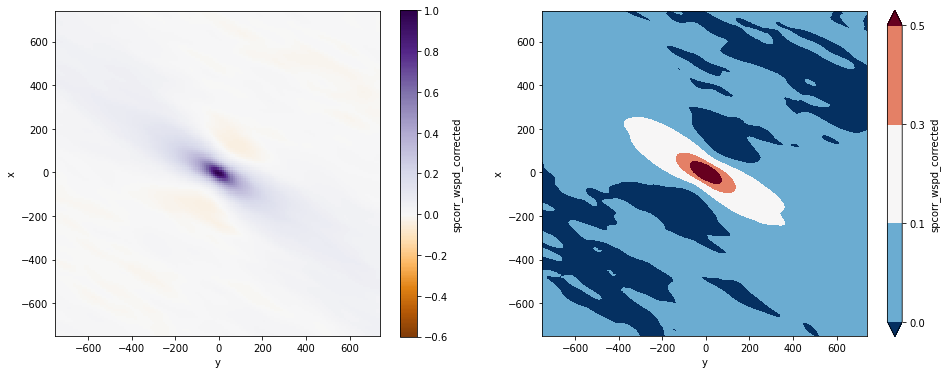

In [41]:
#mean across all 3 hours
fig, axs= plt.subplots(ncols=2, figsize=(16,6))
                               
avgv.mean(dim='datetime').spcorr_wspd_corrected.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
avgv.mean(dim='datetime').spcorr_wspd_corrected.plot.contourf(ax=axs[1], levels=[ 0, 0.1, 0.3, 0.5])

for ax in axs:
    ax.set_ylim([-750, 740])
    ax.set_xlim([-750, 740])
    ax.set_aspect('equal', 'box')

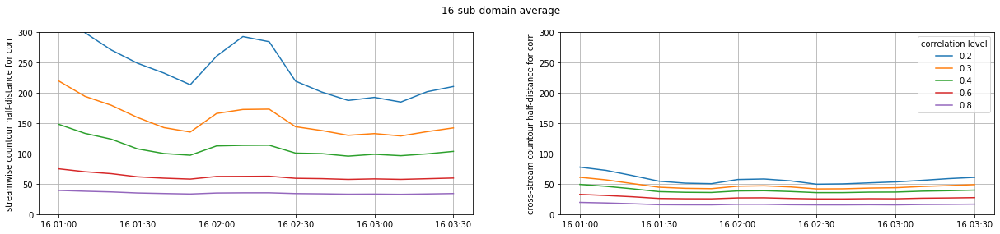

In [42]:
corrList=[0.2,0.3,0.4,0.6,0.8]
a=np.zeros([16, len(corrList)])
b=np.zeros([16, len(corrList)])

for c, corr in enumerate(corrList):
    for t in range(16):
        longarr = np.split(spaceCorr4x4_30['v_long'][t],2)[0]
        tranarr = np.split(spaceCorr4x4_30['v_tran'][t],2)[0]
        longx = np.split(spaceCorr4x4_30['x_long'],2)[0]
        tranx = np.split(spaceCorr4x4_30['x_tran'],2)[0]
        
        idlong = np.abs(longarr - corr).argmin()
        idtran = np.abs(tranarr - corr).argmin()
        #print(f'level {corr}, time {t}: pos long: {idlong}, id tran: {idtran}')
        
        a[t,c] = np.abs(np.interp(corr, longarr[idlong-2:idlong+2], longx[idlong-2:idlong+2]))
        b[t,c] = np.abs(np.interp(corr, tranarr[idtran-2:idtran+2], tranx[idtran-2:idtran+2]))
        
             
fig, axs = plt.subplots(ncols=2, figsize=(17, 4))
for c, corr in enumerate(corrList):
    axs[0].plot(v4x4complete30.datetime, a[:,c], label=corr)
    axs[1].plot(v4x4complete30.datetime, b[:,c], label=corr)

axs[0].set_ylabel('streamwise countour half-distance for corr')
axs[1].set_ylabel('cross-stream countour half-distance for corr')
axs[1].legend(title='correlation level')

for ax in axs: ax.grid(); ax.set_ylim([0,300])

fig.suptitle('16-sub-domain average')
plt.tight_layout()
fig.subplots_adjust(wspace=0.2)
plt.show()

# Temporal autocorrelation vs spatial correlation comparison

The analysis presented below for single-point VTK data matches the results from probe. The probe analysis is not shown here but it was done as a sanity check that the same values are being sampled and considered. Also not shown was the analysis of 1Hz vs higher frequency data. Using 1 Hz and ommitting the specific analysis.


### Notes

- The autocorrelation function `acf`, either with `adjust=False` or `adjust=True`, uses fluctuations around a local mean. Instead of feeding in the original series and let the function do the averaging, we get a 10-min rolling mean and feed in the fluctuations ourselves. This way the fluctuations are more realistic -- created on a rolling 10-min mean as opposed to the whole 30-min series mean. Some investigation into what type of rolling mean to be used has been carried out, including consideration of resampling at 10 minutes the 10-min rolling mean.
- The process described above is perfomed for both the microscale and observation data in order to get fluctuations
- The lag value does not matter. It is, in fact, number of lags, which means a larger value will just have temporal correlations computed for longer. After playing with the dataset, a 2 minute max lag seems appropriate
- In fact, a two minute lag is much longer than the spatial correlation analysis is able to capture. Some plots will be provided to show this
- In this analysis we try to get almost the same data, so only 16 points are used in the case of the 16 sub-domains, and 9 points in the case of 9 sub-domains

In [43]:
# Specify times
ti = 133200
tf3h = ti+ 3*3600
tf4h = ti+ 4*3600

ti_dt =   pd.to_datetime(ti,   unit='s', origin=dateref)
tf3h_dt = pd.to_datetime(tf3h, unit='s', origin=dateref)
tf4h_dt = pd.to_datetime(tf4h, unit='s', origin=dateref)

In [44]:
# Get obs time series
# 3 hours obs (so same time-history length I have for corrected VTK data)
itimes1Hz = np.arange(0,3*3600*10+1, 10, dtype=int)
obs1Hz = obs.isel(datetime=itimes1Hz)
obs1Hzmean = obs1Hz.rolling(datetime=600, min_periods=1).mean()
obs1Hzfluc = obs1Hz-obs1Hzmean

In [45]:
def processAndPlotSpatialVsTemporal (spaceCorr4x4, spaceCorr3x3, intervalInMinutes, windowIncrementInMinutes):
    # ---- `intervalInMinutes`min data
    #spaceCorr4x4=spaceCorr4x4_30
    #spaceCorr3x3=spaceCorr3x3_30

    # Fixed internal
    interval = intervalInMinutes*60 # in min

    # Now fix lag at 2min and window increment at 10min and loop over the entire time
    lag = 120 # 2min
    windowIncrement = windowIncrementInMinutes*60  # in minutes

    # Initialize total arrays to accumulate data
    total_acfn_window_wspd_corrected = []; total_acfnk_window_wspd_corrected = []
    total_acfn_window_obs = [];    total_acfnk_window_obs = []
    tau_acfn_wspd_corrected = [];  tau_acfn_wspd_corrected_0cross = [];  tau_acfn_wspd_corrected_upTo50s = [];   tau_acfn_wspd_corrected_upTo70s = [];
    tau_acfnk_wspd_corrected = []; tau_acfnk_wspd_corrected_0cross = []; tau_acfnk_wspd_corrected_upTo50s = [];  tau_acfnk_wspd_corrected_upTo70s = [];
    tau_acfn_obs = [];             tau_acfn_obs_0cross = [];             tau_acfn_obs_upTo50s = []
    tau_acfnk_obs = [];            tau_acfnk_obs_0cross = [];            tau_acfnk_obs_upTo50s = []

    # Set time limits for get entire array
    ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
    tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
    wspdcorrected_1Hz_ = ds80m_full[['wspd_corrected']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corrected
    wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    




    for w, windowS in enumerate(np.arange(0,180*60-interval+1,windowIncrement)):
        # Window of data used (start and end)
        windowE = windowS + interval

        # ---------------------------------------------------- 16-point corrected time-series from VTK (1Hz)
        cum_acfn_wspd_corrected_1Hz=[];  cum_acfnk_wspd_corrected_1Hz=[];
        for i in np.arange(75, 600, 150):
            for j in np.arange(75, 600, 150):
                # Get data at specific (i,j)
                wspdcorrected_1Hz = wspdcorrected_1Hz_.isel(x=i, y=j)
                # Get 10-min rolling mean
                wspdcorrected_1Hzmean = wspdcorrected_1Hz.rolling(datetime=600, min_periods=1).mean()
                # Get fluctuating component
                wspdcorrected_1Hzfluc = wspdcorrected_1Hz - wspdcorrected_1Hzmean
                # Get desired window
                wspdcorrected_1Hzfluc = wspdcorrected_1Hzfluc.isel(datetime=slice(windowS,windowE))
                # Create time array of length lag
                times_1Hz = np.arange(0, lag+1, 1)
                # Compute autoccorelation
                acfn_wspd_corrected_1Hz =  acf(wspdcorrected_1Hzfluc, nlags=lag, fft=True)
                acfnk_wspd_corrected_1Hz = acf(wspdcorrected_1Hzfluc, nlags=lag, fft=True, adjusted=True)
                # Accumulate autocorrelation for current (i,j)
                cum_acfn_wspd_corrected_1Hz.append(acfn_wspd_corrected_1Hz)
                cum_acfnk_wspd_corrected_1Hz.append(acfnk_wspd_corrected_1Hz)
        cum_acfn_wspd_corrected_1Hz = np.mean(cum_acfn_wspd_corrected_1Hz, axis=0);
        cum_acfnk_wspd_corrected_1Hz = np.mean(cum_acfnk_wspd_corrected_1Hz, axis=0);
        total_acfn_window_wspd_corrected.append(cum_acfn_wspd_corrected_1Hz)
        total_acfnk_window_wspd_corrected.append(cum_acfn_wspd_corrected_1Hz)

        # Compute integral time scales from autocorrelation
        tau_acfn_wspd_corrected.append(np.trapz(cum_acfn_wspd_corrected_1Hz))
        tau_acfn_wspd_corrected_upTo50s.append(np.trapz(cum_acfn_wspd_corrected_1Hz[:52]))
        tau_acfn_wspd_corrected_upTo70s.append(np.trapz(cum_acfn_wspd_corrected_1Hz[:72]))
        tau_acfnk_wspd_corrected.append(np.trapz(cum_acfnk_wspd_corrected_1Hz))
        tau_acfnk_wspd_corrected_upTo50s.append(np.trapz(cum_acfnk_wspd_corrected_1Hz[:52]))
        tau_acfnk_wspd_corrected_upTo70s.append(np.trapz(cum_acfnk_wspd_corrected_1Hz[:72]))
        # get instant that crosses zero
        pos0cross = np.argmax(cum_acfn_wspd_corrected_1Hz<0)
        if pos0cross == 0:
            tau_acfn_wspd_corrected_0cross.append(np.trapz(cum_acfn_wspd_corrected_1Hz))
        else:
            tau_acfn_wspd_corrected_0cross.append(np.trapz(cum_acfn_wspd_corrected_1Hz[:pos0cross]))
        pos0cross = np.argmax(cum_acfnk_wspd_corrected_1Hz<0)
        if pos0cross == 0:
            tau_acfnk_wspd_corrected_0cross.append(np.trapz(cum_acfnk_wspd_corrected_1Hz))
        else:
            tau_acfnk_wspd_corrected_0cross.append(np.trapz(cum_acfnk_wspd_corrected_1Hz[:pos0cross]))



        # -------------------------------------------------------------------- Single-point observation data
        # Get desired window
        wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
        # Create time array of length lag
        times_obs_1Hz = np.arange(0, lag+1, 1)
        # Compute autoccorelation
        acfn_wspd_obs_1Hz  = acf(wspd_obs_1Hz, nlags=lag, fft=True)
        acfnk_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag, fft=True, adjusted=True)
        total_acfn_window_obs.append(acfn_wspd_obs_1Hz)
        total_acfnk_window_obs.append(acfnk_wspd_obs_1Hz)

        # Compute integral time scales from autocorrelation
        tau_acfn_obs.append(np.trapz(acfn_wspd_obs_1Hz))
        tau_acfn_obs_upTo50s.append(np.trapz(acfn_wspd_obs_1Hz[:52]))
        tau_acfnk_obs.append(np.trapz(acfnk_wspd_obs_1Hz))
        tau_acfnk_obs_upTo50s.append(np.trapz(acfnk_wspd_obs_1Hz[:52]))
        # get instant that crosses zero
        pos0cross = np.argmax(acfn_wspd_obs_1Hz<0)
        if pos0cross == 0:
            tau_acfn_obs_0cross.append(np.trapz(acfn_wspd_obs_1Hz))
        else:
            tau_acfn_obs_0cross.append(np.trapz(acfn_wspd_obs_1Hz[:pos0cross]))
        pos0cross = np.argmax(acfnk_wspd_obs_1Hz<0)
        if pos0cross == 0:
            tau_acfnk_obs_0cross.append(np.trapz(acfnk_wspd_obs_1Hz))
        else:
            tau_acfnk_obs_0cross.append(np.trapz(acfnk_wspd_obs_1Hz[:pos0cross]))





    # ---------------------------------------------------------------------
    # ------------------------------- PLOTS -------------------------------
    fig, axs = plt.subplots(ncols=2, nrows=7, figsize=(18,30), gridspec_kw={'hspace': 0.25, 'wspace':0.15});

    # --------- Color definitions
    # obs wspd data
    axs[0,0].set_prop_cycle('color',[plt.cm.Blues(i)  for i in np.linspace(0.3, 0.9, len(tau_acfn_wspd_corrected))])
    # time-series corrected wspd data
    axs[1,0].set_prop_cycle('color',[plt.cm.Greens(i) for i in np.linspace(0.3, 0.9, len(tau_acfn_wspd_corrected))])
    # spatial correlation corrected wspd data on a 4x4 grid of sub-domains
    axs[2,0].set_prop_cycle('color',[plt.cm.Greys(i)   for i in np.linspace(0.3, 0.9, len(spaceCorr4x4['L_long_']))])
    # time domain spatial correlation of corrected wspd data on a 4x4 grid of sub-domains
    axs[3,0].set_prop_cycle('color',[plt.cm.Reds(i)  for i in np.linspace(0.3, 0.9, len(spaceCorr4x4['L_long_']))])
    # spatial correlation corrected wspd data on a 3x3 grid of sub-domains
    axs[4,0].set_prop_cycle('color',[plt.cm.Purples(i)   for i in np.linspace(0.3, 0.9, len(spaceCorr3x3['L_long_']))])
    # time domain spatial correlation of corrected wspd data on a 3x3 grid of sub-domains
    axs[5,0].set_prop_cycle('color',[plt.cm.Oranges(i)  for i in np.linspace(0.3, 0.9, len(spaceCorr3x3['L_long_']))])


    # multiple ligher shade curve per interval
    for p in range(len(tau_acfn_wspd_corrected)):
        # obs
        axs[0,0].plot(times_obs_1Hz, total_acfn_window_obs[p],   alpha=0.25);
        # time-series of corrected wspd data
        axs[1,0].plot(times_1Hz, total_acfn_window_wspd_corrected[p], alpha=0.25);
        # spatial correlation of corrected wspd data on a 4x4 grid of sub-domains
        axs[2,0].plot(spaceCorr4x4['x_long'], spaceCorr4x4['v_long'][p], alpha=0.25)
        # time domain spatial correlation of corrected wspd data on a 4x4 grid of sub-domains
        wspd = spaceCorr4x4['L_long_'][p]/spaceCorr4x4['tau_long_'][p]
        axs[3,0].plot(spaceCorr4x4['x_long']/wspd, spaceCorr4x4['v_long'][p], alpha=0.25)
        # spatial correlation of corrected wspd data on a 3x3 grid of sub-domains
        axs[4,0].plot(spaceCorr3x3['x_long'], spaceCorr3x3['v_long'][p], alpha=0.25)
        # time domain spatial correlation of corrected wspd data on a 4x4 grid of sub-domains
        wspd = spaceCorr3x3['L_long_'][p]/spaceCorr3x3['tau_long_'][p]
        axs[5,0].plot(spaceCorr3x3['x_long']/wspd, spaceCorr3x3['v_long'][p], alpha=0.25)

    # dark-shade mean curve
    axs[0,0].plot(times_obs_1Hz, np.vstack(total_acfn_window_obs).mean(axis=0),                     c='tab:blue',   label='single-point obs autocorrelation 2-min lag')
    axs[1,0].plot(times_1Hz, np.vstack(total_acfn_window_wspd_corrected).mean(axis=0),  c='tab:green',  label='16-point corrected autocorrelation 2-min lag')
    axs[2,0].plot(spaceCorr4x4['x_long'], spaceCorr4x4['v_long'].mean(axis=0),          c='tab:gray',    label='16-subdomain mean spatial correlation')
    meanwspd = np.mean(np.array(spaceCorr4x4['L_long_'])/np.array(spaceCorr4x4['tau_long_']))
    axs[3,0].plot(spaceCorr4x4['x_long']/meanwspd, spaceCorr4x4['v_long'].mean(axis=0), c='tab:red',   label='16-subdomain mean spatial correlation/mean wspd')
    axs[4,0].plot(spaceCorr3x3['x_long'], spaceCorr3x3['v_long'].mean(axis=0),          c='tab:purple', label='9-subdomain mean spatial correlation')
    meanwspd = np.mean(np.array(spaceCorr3x3['L_long_'])/np.array(spaceCorr3x3['tau_long_']))
    axs[5,0].plot(spaceCorr3x3['x_long']/meanwspd, spaceCorr3x3['v_long'].mean(axis=0), c='tab:orange', label='9-subdomain mean spatial correlation/mean wspd')


    # Integral scales plots (second columns)
    timeperiodlen = len(tau_acfn_obs_0cross)
    assert isinstance(windowIncrementInMinutes, int)
    freq=str(windowIncrementInMinutes)+'min'
    axs[0,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_obs_0cross,           c='tab:blue',ls='solid',    label='int up to 0-cross')
    axs[0,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_obs_upTo50s,          c='tab:blue',ls='dashed',   label='int up to 50s')
    axs[0,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_obs,                  c='tab:blue',ls='dashdot',  label='int entire curve')

    axs[1,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_0cross,  c='tab:green',ls='solid',   label='int up to 0-cross')
    axs[1,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_upTo50s, c='tab:green',ls='dashed',  label='int up to 50s')
    axs[1,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_upTo70s, c='tab:green',ls='dotted',  label='int up to 70s')

    axs[2,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr4x4['tau_long_'],       c='tab:gray',ls='dashed', label='int L/mean(wspd) up to 0-cross')
    #axs[2,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), np.array(spaceCorr4x4['L_long_'])/np.array(spaceCorr4x4['tau_long_']), 'c--', label='wspd (in m/s)')

    axs[3,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr4x4['L_long_'],         c='tab:red', label='int L up to 0-cross')

    axs[4,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr3x3['tau_long_'],       c='tab:purple',ls='dotted', label='int L/mean(wspd) up to 0-cross')
    #axs[4,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), np.array(spaceCorr3x3['L_long_'])/np.array(spaceCorr3x3['tau_long_']), 'c--', label='wspd (in m/s)')

    axs[5,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr3x3['L_long_'],         c='tab:orange', label='int L up to 0-cross')


    # Last row of plots, with the dark-shade curve of every time-domain plot
    axs[6,0].plot(times_obs_1Hz, np.vstack(total_acfn_window_obs).mean(axis=0),                     c='tab:blue',   label='single-point obs autocorrelation 2-min lag')
    axs[6,0].plot(times_1Hz, np.vstack(total_acfn_window_wspd_corrected).mean(axis=0),  c='tab:green',  label='16-point time-series autocorrelation 2-min lag')
    meanwspd = np.mean(np.array(spaceCorr4x4['L_long_'])/np.array(spaceCorr4x4['tau_long_']))
    axs[6,0].plot(spaceCorr4x4['x_long']/meanwspd, spaceCorr4x4['v_long'].mean(axis=0), c='tab:red',   label='16-subdomain mean spatial correlation/mean wspd')
    meanwspd = np.mean(np.array(spaceCorr3x3['L_long_'])/np.array(spaceCorr3x3['tau_long_']))
    axs[6,0].plot(spaceCorr3x3['x_long']/meanwspd, spaceCorr3x3['v_long'].mean(axis=0), c='tab:orange', label='9-subdomain mean spatial correlation/mean wspd')

    axs[6,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_0cross,  c='tab:green',ls='solid',  label='16-point time-series int up to 0-cross')
    axs[6,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_upTo50s, c='tab:green',ls='dashed', label='16-point time-series int up to 50s')
    axs[6,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr4x4['tau_long_'],       c='tab:gray', ls='dashed', label='16-subdomain spatial int L/mean(wspd) (up to ~50s only)')
    axs[6,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), tau_acfn_wspd_corrected_upTo70s, c='tab:green',ls='dotted', label='16-point time-series int up to 70s')
    axs[6,1].plot(pd.date_range(start=LESfrom, freq=freq, periods=timeperiodlen), spaceCorr3x3['tau_long_'],       c='tab:purple',ls='dotted', label='9-subdomain spatial int L/mean(wspd) (up to ~70s only)')



    # Labels and annotations
    fig.suptitle(f'{interval/60:.1f}min-long intervals, 2min lag for temporal autocorrelations', fontsize=14, y=0.9);
    for ax in axs.flatten():  ax.grid(); ax.legend(loc='upper right')
    for ax in axs[:,1]:       ax.set_xlabel('time (UTC)');
    for ax in axs[:,0]:       ax.set_ylabel('correlation'); ax.set_ylim([-0.2, 1]);
    axs[0,0].set_xlim([0, 125]);          axs[1,0].set_xlim([0, 125]);        axs[3,0].set_xlim([0, 125]);        axs[5,0].set_xlim([0, 125]);     axs[6,0].set_xlim([0, 125]);    
    axs[0,0].set_xlabel('seconds');       axs[1,0].set_xlabel('seconds');     axs[3,0].set_xlabel('seconds');     axs[5,0].set_xlabel('seconds');  axs[6,0].set_xlabel('seconds');
    axs[2,0].set_xlim([0, 800]);          axs[4,0].set_xlim([0, 800]);
    axs[2,0].set_xlabel('distance (m)');  axs[4,0].set_xlabel('distance (m)');

    for ax in [axs[0,1], axs[1,1], axs[2,1], axs[4,1], axs[6,1]]:   ax.set_ylabel('int time scale (s)');  ax.set_ylim([7, 20])
    for ax in [axs[3,1], axs[5,1]]:   ax.set_ylabel('int length scale (m)');  ax.set_ylim([100, 250])

    plt.show()

### 30-min chunks

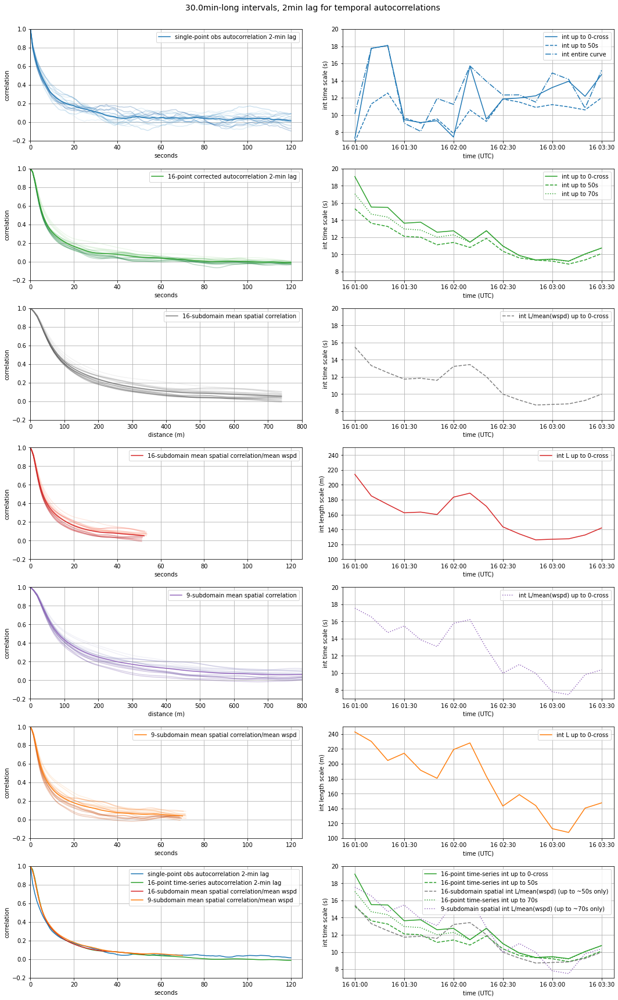

In [46]:
processAndPlotSpatialVsTemporal(spaceCorr4x4=spaceCorr4x4_30, spaceCorr3x3=spaceCorr3x3_30, intervalInMinutes=30, windowIncrementInMinutes=10)

### 20-min chunks

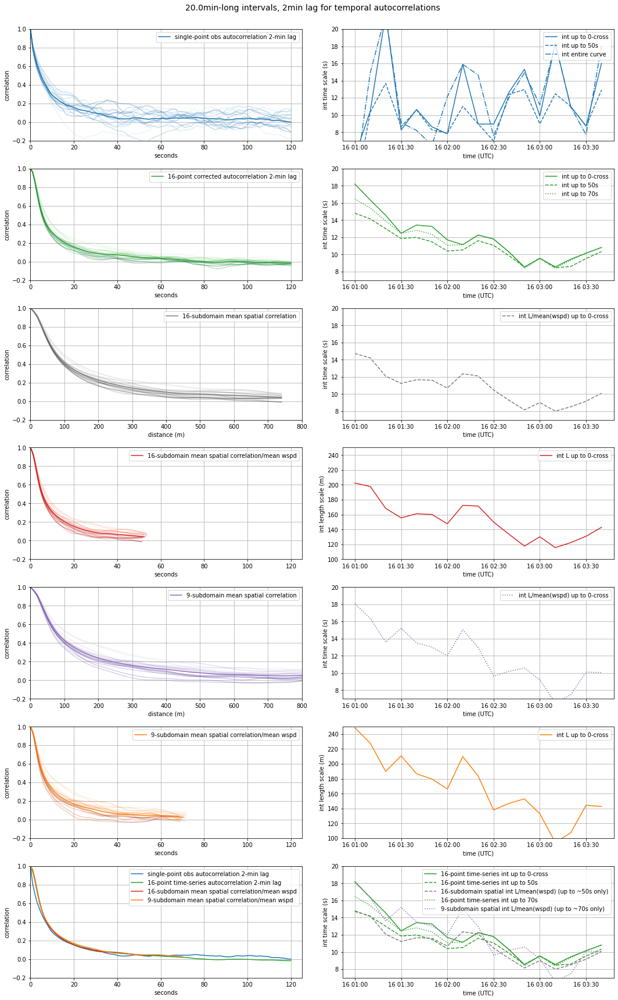

In [47]:
processAndPlotSpatialVsTemporal(spaceCorr4x4=spaceCorr4x4_20, spaceCorr3x3=spaceCorr3x3_20, intervalInMinutes=20, windowIncrementInMinutes=10)

### 15-min chunks

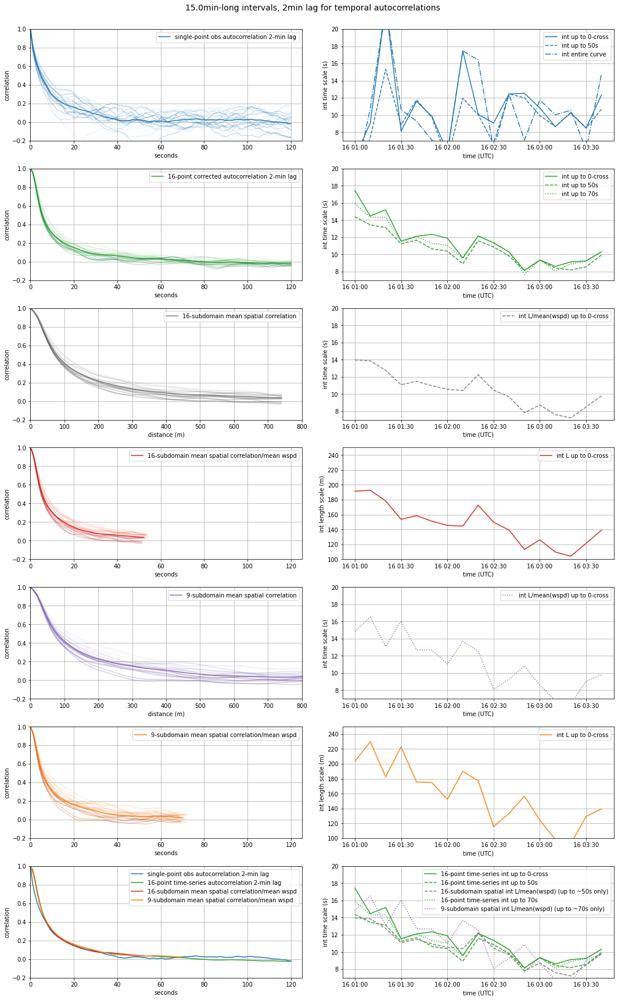

In [48]:
processAndPlotSpatialVsTemporal(spaceCorr4x4=spaceCorr4x4_15, spaceCorr3x3=spaceCorr3x3_15, intervalInMinutes=15, windowIncrementInMinutes=10)

### 10-min chunks


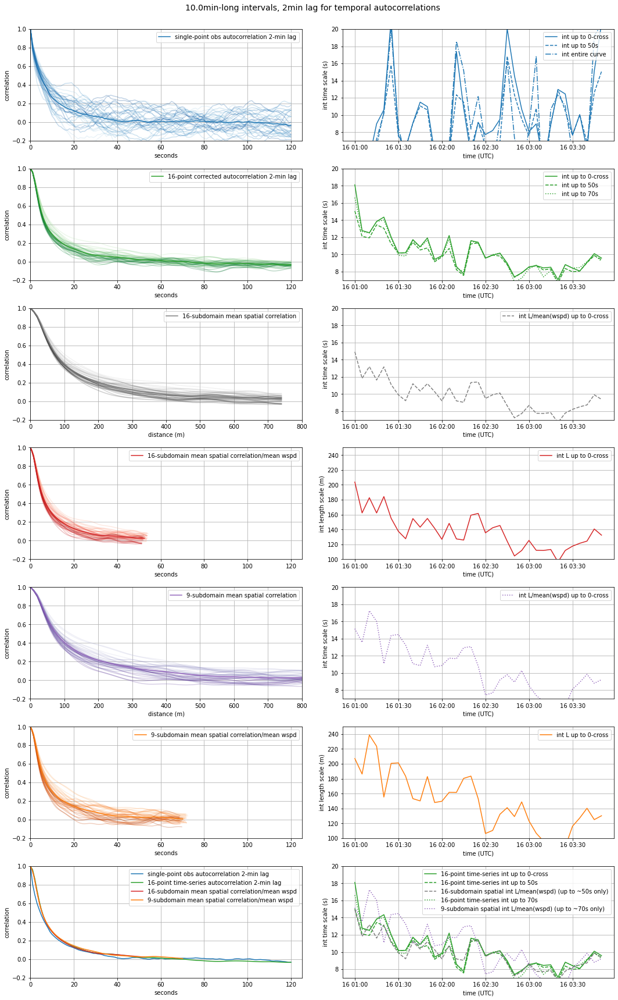

In [49]:
processAndPlotSpatialVsTemporal(spaceCorr4x4=spaceCorr4x4_10, spaceCorr3x3=spaceCorr3x3_10, intervalInMinutes=10, windowIncrementInMinutes=5)